In [2]:
# uncomment this if you have cuda and want to specify the device
#import os
#os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [5]:
import numpy as np
import cv2
import glob
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import tqdm
import seaborn as sns
import torchvision
import torch
import PIL
from PIL import Image
import json

def show_image(image, figsize=(16, 9), reverse=True):
    plt.figure(figsize=figsize)
    if reverse:
        plt.imshow(image[...,::-1])
    else:
        plt.imshow(image)
    plt.axis('off')
    plt.show()

def save_to_json(filename, data):
    with open(filename, 'w') as f:
        return json.dump(data, f)
    
def load_from_json(filename):
    with open(filename, 'r') as f:
        return json.load(f)

# Load COCO info

Useful links:
http://cocodataset.org/#home

 - 330K images (>200K labeled)
 - 1.5 million object instances
 - 80 object categories

In [6]:
root = "/kaggle/input/detect-1-data/"

In [7]:
# download all class names from json file
coco_id_to_name = load_from_json(root + "coco_id_to_name.json")
coco_id_to_name = {int(key): value for key, value in coco_id_to_name.items()}
len(coco_id_to_name)

80

In [8]:
print(*list(coco_id_to_name.values()))

person bicycle car motorcycle airplane bus train truck boat traffic light fire hydrant stop sign parking meter bench bird cat dog horse sheep cow elephant bear zebra giraffe backpack umbrella handbag tie suitcase frisbee skis snowboard sports ball kite baseball bat baseball glove skateboard surfboard tennis racket bottle wine glass cup fork knife spoon bowl banana apple sandwich orange broccoli carrot hot dog pizza donut cake chair couch potted plant bed dining table toilet tv laptop mouse remote keyboard cell phone microwave oven toaster sink refrigerator book clock vase scissors teddy bear hair drier toothbrush


# Sample run

In [9]:
file = root + 'detection_examples/mrs_maisel.jpg'

https://github.com/pytorch/vision/blob/c732dfe2a4b1c861d8d1fedd7999f473f8cd3142/torchvision/models/detection/faster_rcnn.py#L24

In [10]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, progress=True,
                            num_classes=91, pretrained_backbone=True)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

In [11]:
from torchvision import transforms

to_tensor = transforms.ToTensor()

def val_transform(img):
    """
    Transform image (pil.image(image_path)) to tensor with shape: (num_channels, width, height) 
    and add first dimension to make batch with size 1. There is no need normalization, becouse
    neural net do this procedure.
    """
    img_tensor = to_tensor(img)
    return img_tensor.unsqueeze(0)

def visualize_prediction(file, model, device='cpu', verbose=True, thresh=0.0, n_colors=None):
    img = Image.open(file)
    img_tensor = val_transform(img)
    model.to(device)
    model.eval()
    with torch.no_grad():
        predictions = model(img_tensor.to(device)) # list of size 1
        
    prediction = predictions[0] # prdiction for a single object in batch_size, 
    # prediction is dictinary, boxes - coordinats, labels - probs for classes
    
    # 
    if n_colors is None:
        n_colors = model.roi_heads.box_predictor.cls_score.out_features
    
    # get n different collors
    palette = sns.color_palette(None, n_colors)
    
    # visualize
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    for i in range(len(prediction['boxes'])):
        x1, x2, x3, x4 = map(int, prediction['boxes'][i].tolist())
        label = int(prediction['labels'][i].cpu())
        score = float(prediction['scores'][i].cpu())
        name = coco_id_to_name[label]
        color = palette[label]
        if verbose:
            if score > thresh:
                print ('Class: {}, Confidence: {}'.format(name, score))
        if score > thresh:
            image = cv2.rectangle(img, (x1, x2), (x3, x4), np.array(color) * 255, 2)
            cv2.putText(image, name, (x1, x2-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color) * 255, 2)
    show_image(image)
    return prediction

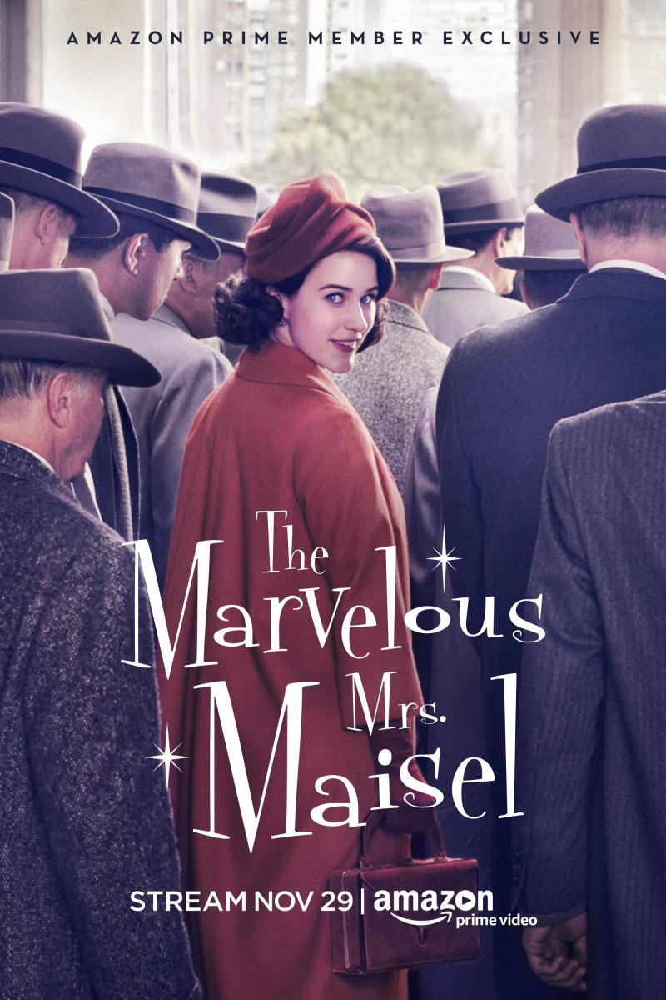

In [12]:
img = Image.open(file)
img

Class: person, Confidence: 0.9956188797950745
Class: person, Confidence: 0.9719012379646301
Class: person, Confidence: 0.970834493637085
Class: person, Confidence: 0.9520890116691589
Class: person, Confidence: 0.9492106437683105
Class: person, Confidence: 0.944884717464447
Class: person, Confidence: 0.9257946610450745
Class: person, Confidence: 0.8480135798454285
Class: person, Confidence: 0.7299466133117676
Class: person, Confidence: 0.6387625336647034
Class: tie, Confidence: 0.595008373260498
Class: person, Confidence: 0.4871276915073395
Class: person, Confidence: 0.43352410197257996
Class: chair, Confidence: 0.40261921286582947
Class: person, Confidence: 0.39921122789382935
Class: person, Confidence: 0.39902275800704956
Class: person, Confidence: 0.3596394658088684
Class: person, Confidence: 0.3151041567325592
Class: person, Confidence: 0.311618447303772
Class: person, Confidence: 0.30801811814308167
Class: person, Confidence: 0.27895838022232056
Class: person, Confidence: 0.2613491

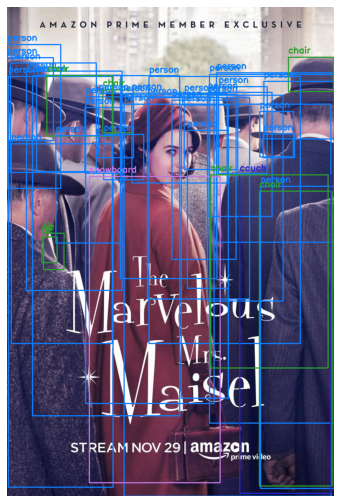

In [13]:
out = visualize_prediction(file, model)

Class: person, Confidence: 0.9956188797950745
Class: person, Confidence: 0.9719012379646301
Class: person, Confidence: 0.970834493637085
Class: person, Confidence: 0.9520890116691589
Class: person, Confidence: 0.9492106437683105
Class: person, Confidence: 0.944884717464447
Class: person, Confidence: 0.9257946610450745
Class: person, Confidence: 0.8480135798454285


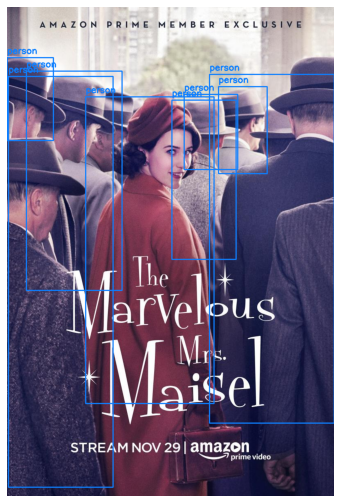

In [14]:
out = visualize_prediction(file, model, thresh=0.8)

# Еще один пример

In [15]:
file = root + 'detection_examples/junk_food.jpg'

Class: person, Confidence: 0.9768175482749939
Class: person, Confidence: 0.9621938467025757
Class: person, Confidence: 0.9575484395027161
Class: person, Confidence: 0.9556086659431458
Class: person, Confidence: 0.8266395330429077
Class: sandwich, Confidence: 0.8228336572647095
Class: hot dog, Confidence: 0.8058621883392334
Class: person, Confidence: 0.5006350874900818
Class: sandwich, Confidence: 0.4936736822128296
Class: person, Confidence: 0.4863045811653137
Class: bowl, Confidence: 0.4468251168727875
Class: person, Confidence: 0.4429803192615509
Class: cake, Confidence: 0.2984029948711395
Class: sandwich, Confidence: 0.2689809203147888
Class: cup, Confidence: 0.24261285364627838
Class: person, Confidence: 0.22883792221546173
Class: dining table, Confidence: 0.2124602198600769
Class: cell phone, Confidence: 0.20239897072315216
Class: person, Confidence: 0.1762571781873703
Class: cell phone, Confidence: 0.17373207211494446
Class: sandwich, Confidence: 0.16651034355163574
Class: hot do

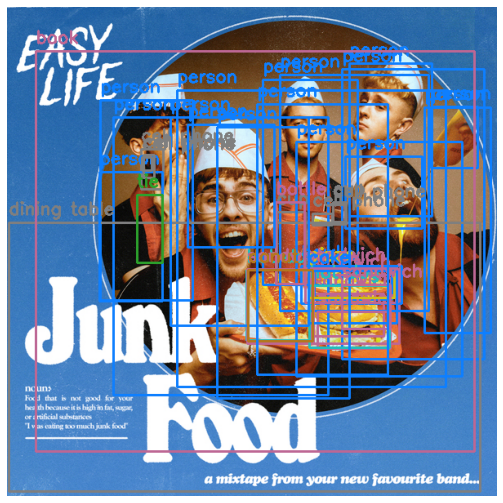

In [16]:
out = visualize_prediction(file, model)

Class: person, Confidence: 0.9768175482749939
Class: person, Confidence: 0.9621938467025757
Class: person, Confidence: 0.9575484395027161
Class: person, Confidence: 0.9556086659431458
Class: person, Confidence: 0.8266395330429077
Class: sandwich, Confidence: 0.8228336572647095
Class: hot dog, Confidence: 0.8058621883392334


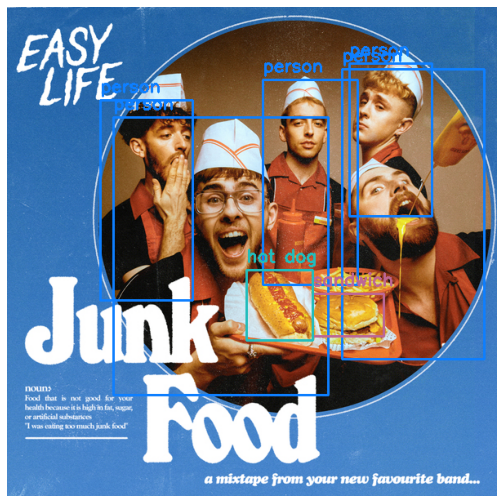

In [17]:
out = visualize_prediction(file, model, thresh=0.8)

Class: person, Confidence: 0.9768175482749939
Class: person, Confidence: 0.9621938467025757
Class: person, Confidence: 0.9575484395027161
Class: person, Confidence: 0.9556086659431458
Class: person, Confidence: 0.8266395330429077
Class: sandwich, Confidence: 0.8228336572647095
Class: hot dog, Confidence: 0.8058621883392334
Class: person, Confidence: 0.5006350874900818
Class: sandwich, Confidence: 0.4936736822128296
Class: person, Confidence: 0.4863045811653137
Class: bowl, Confidence: 0.4468251168727875
Class: person, Confidence: 0.4429803192615509


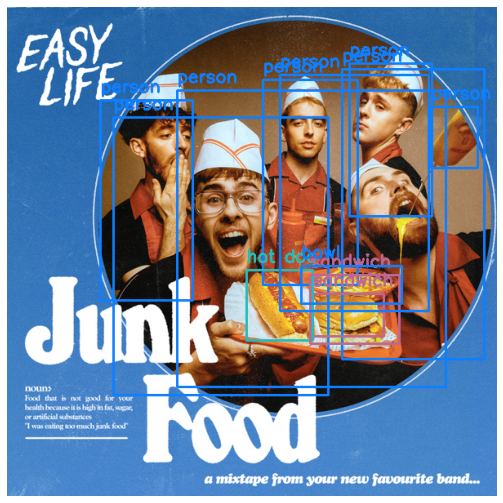

In [18]:
out = visualize_prediction(file, model, thresh=0.4)

In [40]:
cd /kaggle/input/detect-1-data

/kaggle/input/detect-1-data


In [37]:
list(coco_id_to_name.values())[:10]

['person',
 'bicycle',
 'car',
 'motorcycle',
 'airplane',
 'bus',
 'train',
 'truck',
 'boat',
 'traffic light']

# Давайте дообучимся на что-нибудь новое: номерные знаки

### Датасет Open images:
https://storage.googleapis.com/openimages/web/index.html

In [42]:
filename_to_bbox_train_dict = load_from_json('filename_to_bbox_train.json')
filename_to_bbox_val_dict = load_from_json('filename_to_bbox_val.json')
len(filename_to_bbox_train_dict), len(filename_to_bbox_val_dict)

(1313, 200)

# Визуализируем датасет

In [43]:
def visualize_from_dataset(file, filename_to_bbox_dict):
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    for i in range(len(filename_to_bbox_dict[file])):
        x_min, x_max, y_min, y_max = filename_to_bbox_dict[file][i]
        x_min, y_min, x_max, y_max = int(x_min * w), int(y_min * h), int(x_max * w), int(y_max * h)
        image = cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    show_image(image)

In [31]:
# for kaggle
def add_root(file):
    global root
    return root + file

In [33]:
train_filenames = list(filename_to_bbox_train_dict.keys())
# for kaggle
train_filenames = list(map(add_root, train_filenames))
train_filenames[:10]

['/kaggle/input/detect-1-data/./number_plates/00200.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00201.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00202.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00203.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00204.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00205.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00206.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00207.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00208.jpg',
 '/kaggle/input/detect-1-data/./number_plates/00209.jpg']

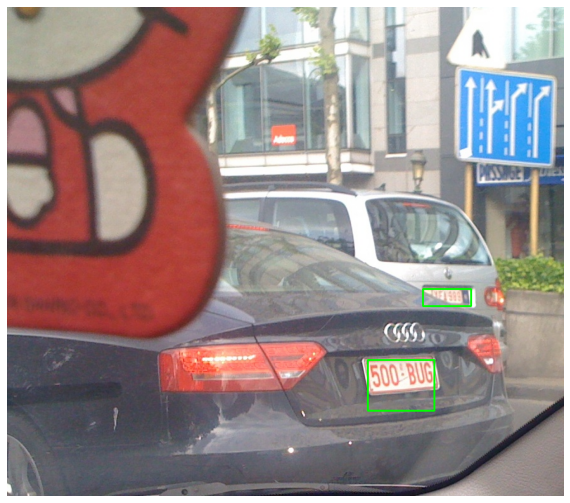

In [46]:
train_filenames = list(filename_to_bbox_train_dict.keys())
filename = np.random.choice(train_filenames)
visualize_from_dataset(filename, filename_to_bbox_train_dict)

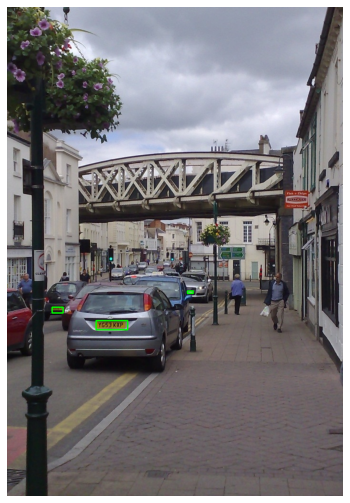

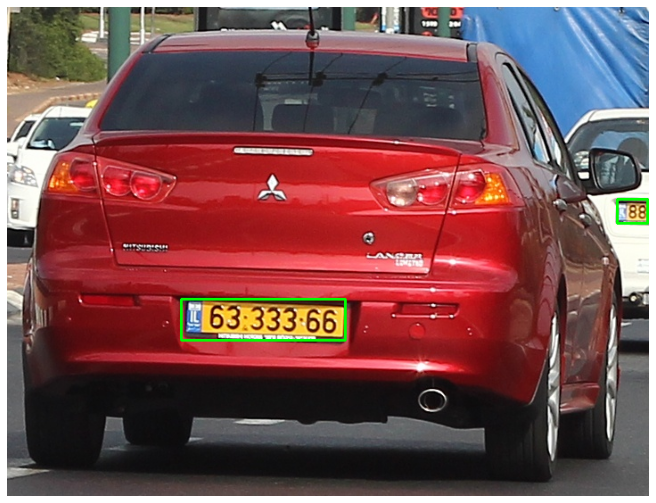

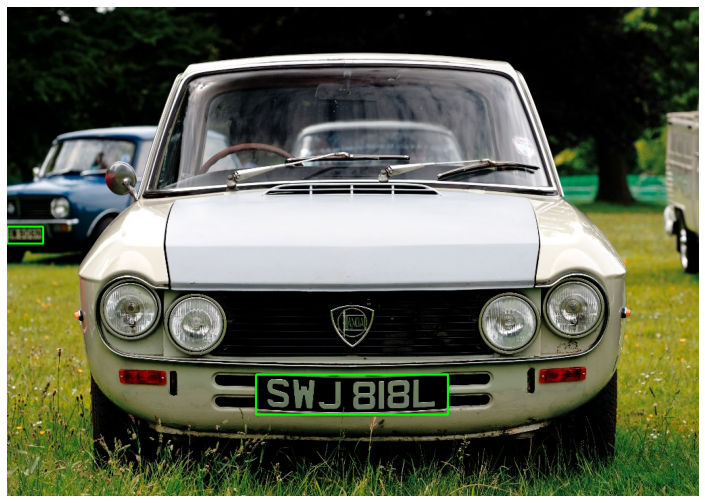

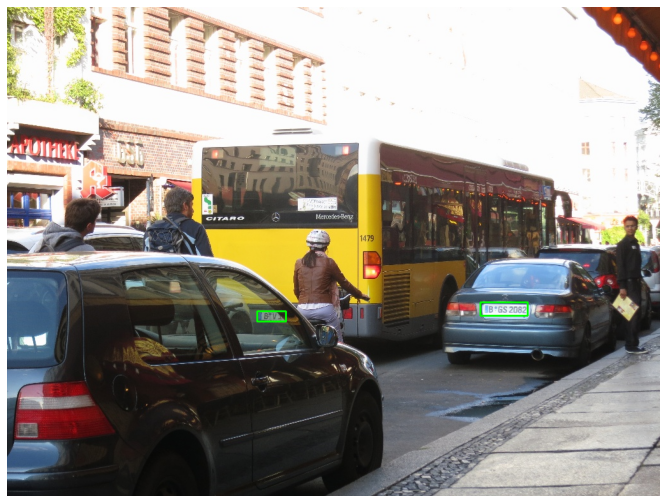

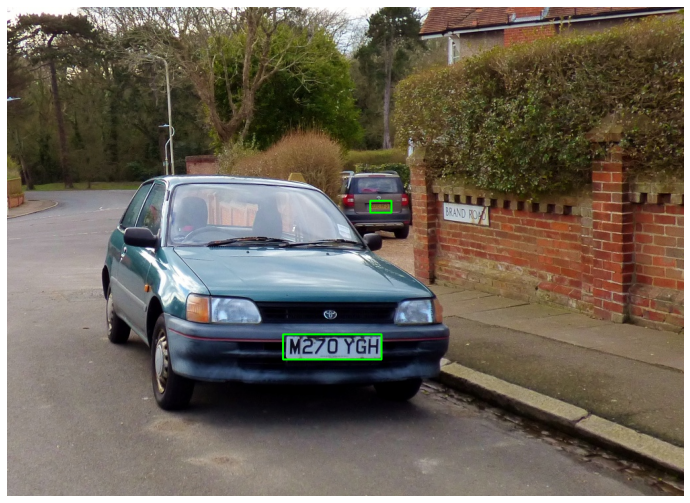

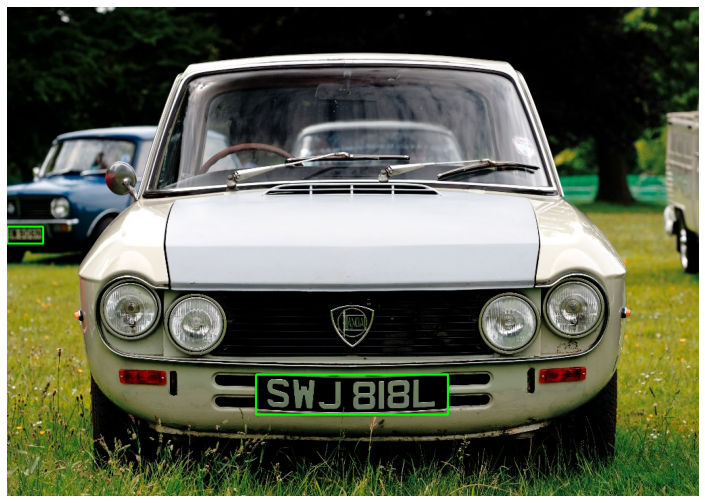

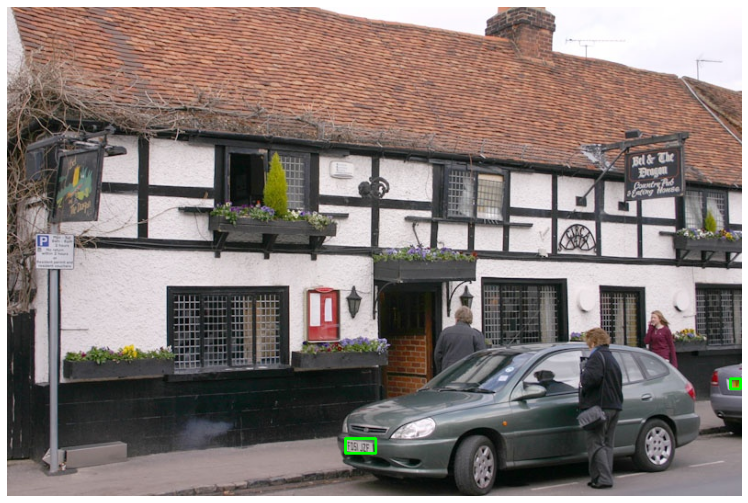

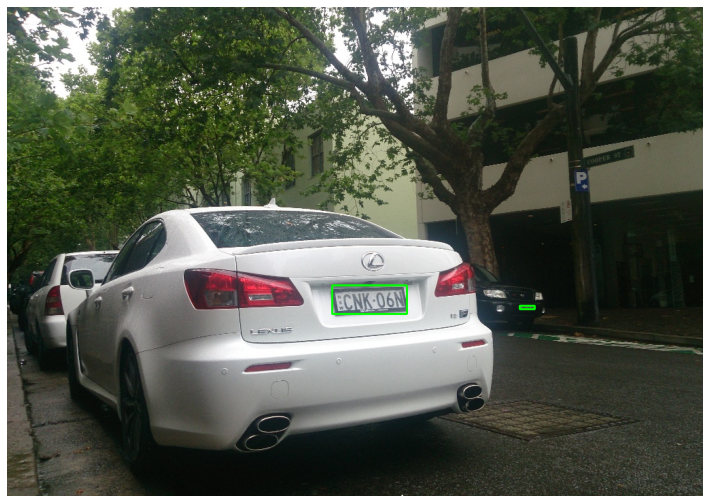

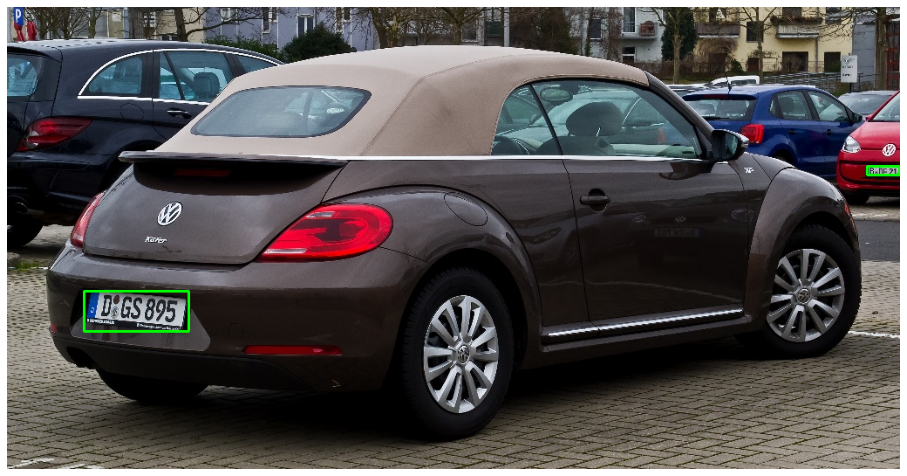

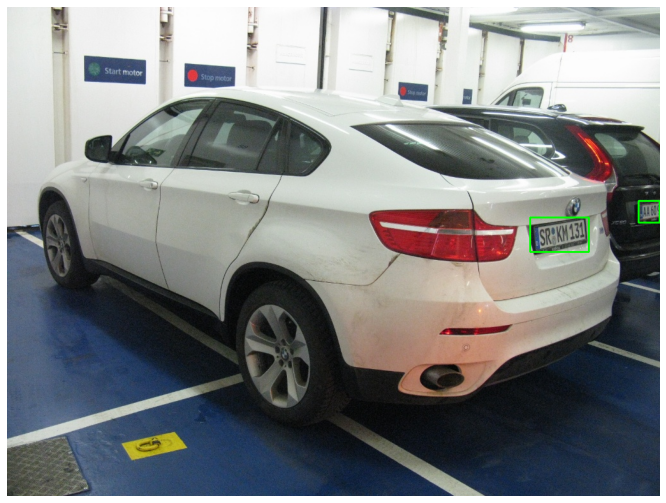

In [47]:
val_filenames = list(filename_to_bbox_val_dict.keys())
for filename in np.random.choice(val_filenames, 10):
    visualize_from_dataset(filename, filename_to_bbox_val_dict)

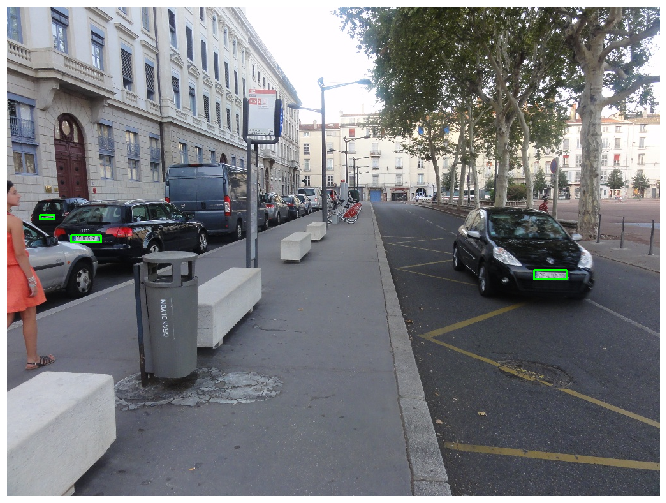

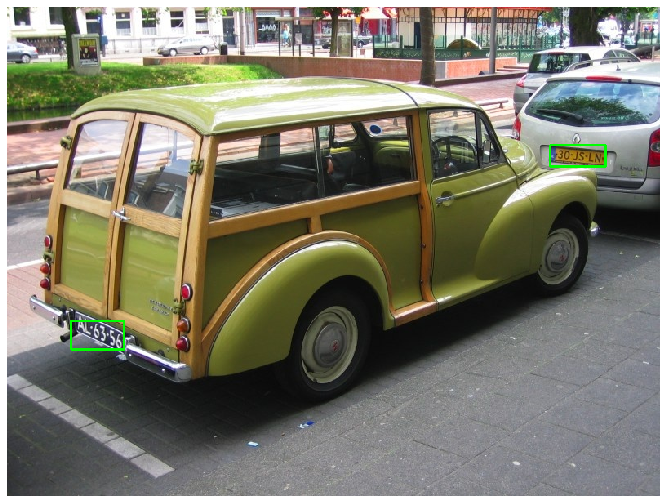

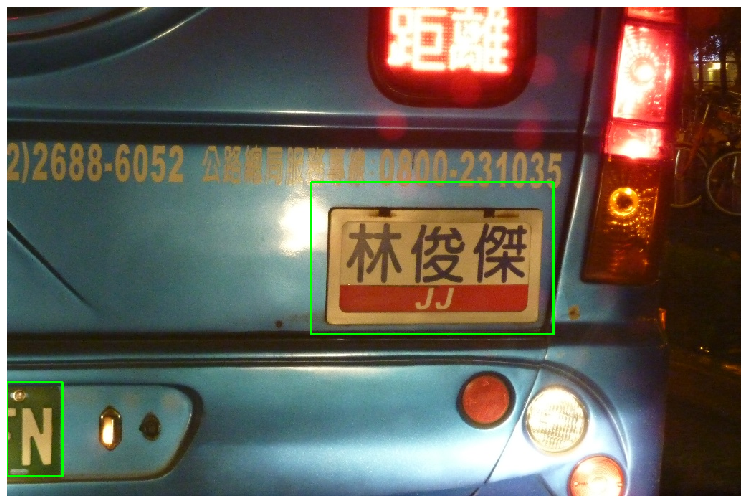

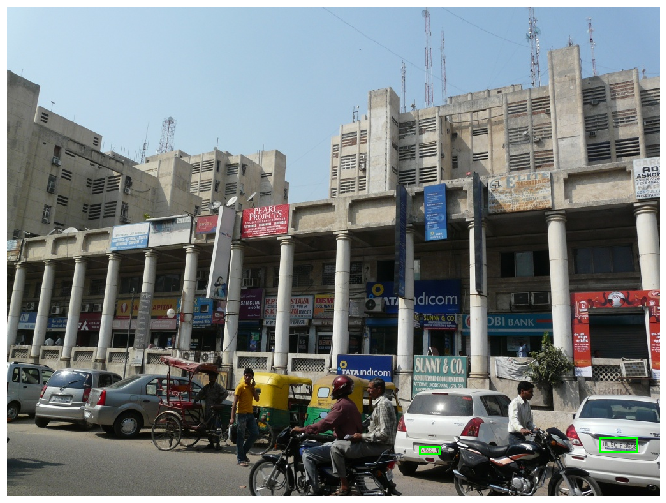

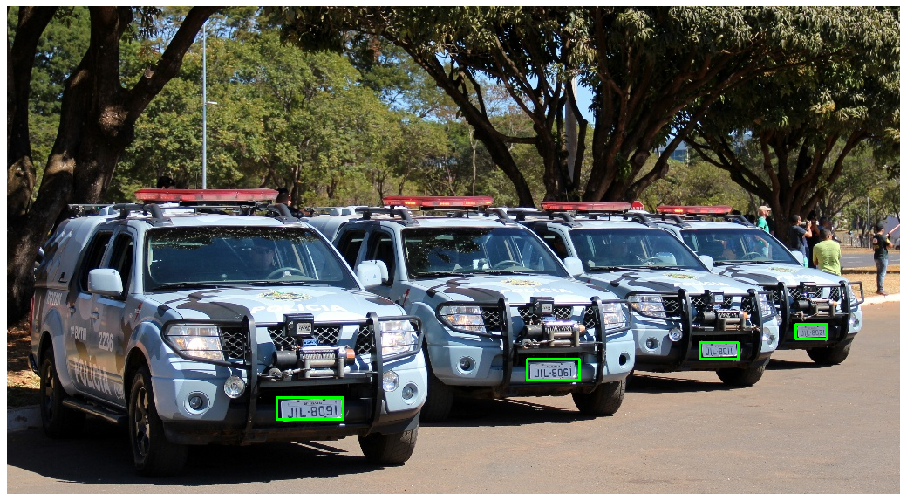

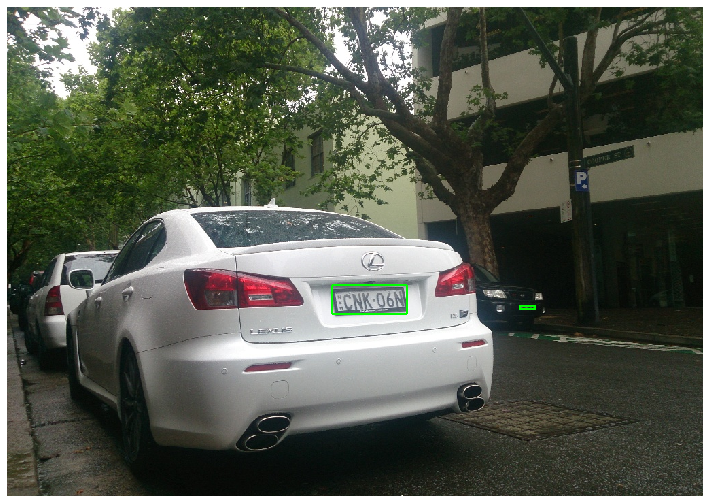

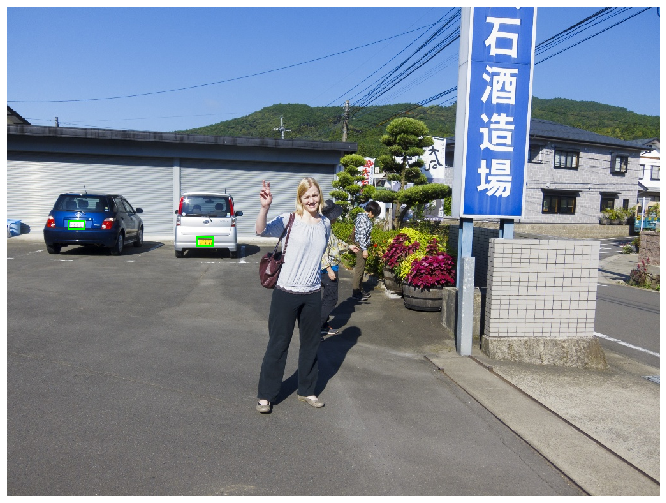

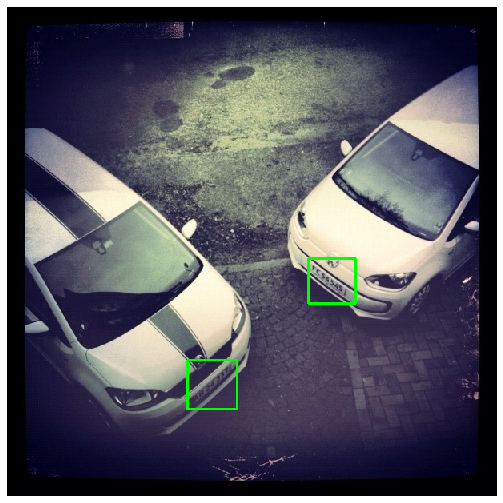

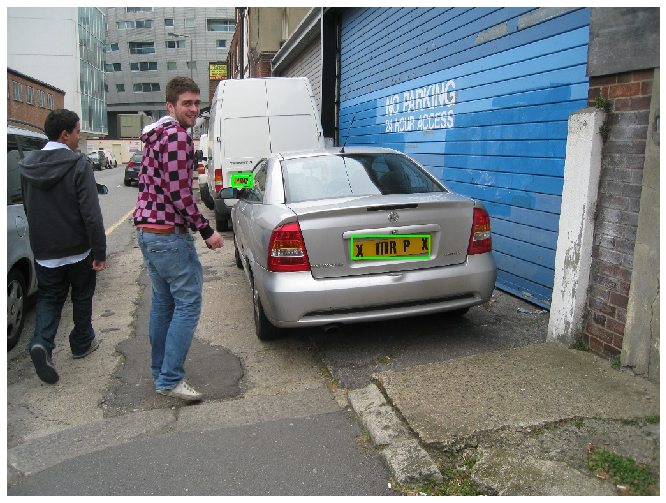

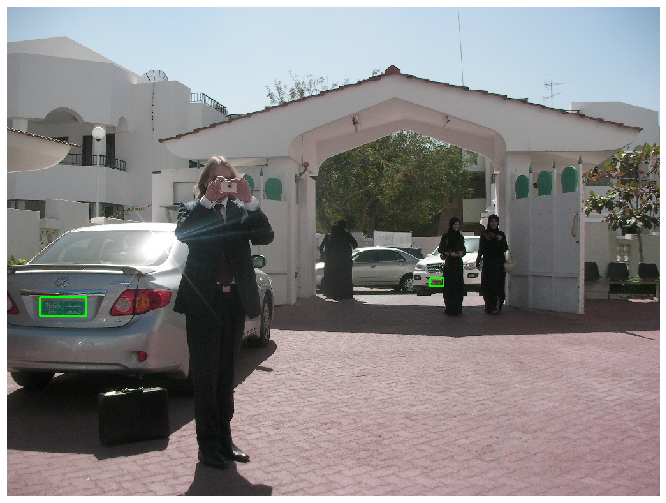

# Создадим класс датасета

In [48]:
import os
import numpy as np
import torch
import torch.utils.data
from PIL import Image
import json
from torchvision import transforms

class DetectionDataset(torch.utils.data.Dataset):
    def __init__(self, data_dict_file, transforms=None):
        
        # transforms for image
        self.transforms = transforms
        
        # get all image files as list of files paths
        with open(data_dict_file, 'r') as f:
            self.data_dict = json.load(f)
        # list all image paths
        self.imgs = list(self.data_dict.keys())
        
    def __getitem__(self, idx):
        # load images ad masks
        img_path = self.imgs[idx]
        # change channels arangment from bgr to rgb (the channel arangment depends from dataset)
        img = Image.open(img_path).convert("RGB")
        w, h = img.size
        
        # how many objects (box) is on the image
        num_objs = len(self.data_dict[img_path])
        boxes = []
        for i in range(num_objs):
            bbox = self.data_dict[img_path][i]
            # the coordinats are in the relative units, so we have to conver it to absolute values
            xmin = bbox[0] * w
            xmax = bbox[1] * w
            ymin = bbox[2] * h
            ymax = bbox[3] * h
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # there is only one class
        labels = torch.ones((num_objs,), dtype=torch.int64)
        
        # is crowd, this is need fro human detection, if there is a crowd, the model doesn't 
        # detect every human, they only detect all humants as crowd. We need to add this class
        # to correct work of package
        
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
         
        # image id
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms is not None:
            img = self.transforms(img)

        return img, target
    
    def __len__(self):
        return len(self.imgs)

# Create transforms

In [49]:
img_transforms = transforms.Compose([
    transforms.ToTensor()
])

# Load datasets

In [52]:
# collate_fn needs for batch
def collate_fn(batch):
    # to get batch as tuple, not tensor
    return tuple(zip(*batch))

In [50]:
# use our dataset and defined transformations
train_dataset = DetectionDataset('filename_to_bbox_train.json', img_transforms)
val_dataset = DetectionDataset('filename_to_bbox_val.json', img_transforms)

print(len(train_dataset), len(val_dataset))

1313 200


# Make dataloaders

In [55]:
# define training and validation data loaders
# we drop the last batch if it isn't complete. This was done to don't mess up the stats
data_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=4, shuffle=True, num_workers=2,
    collate_fn=collate_fn, drop_last=True)

data_loader_val = torch.utils.data.DataLoader(
    val_dataset, batch_size=4, shuffle=False, num_workers=1,
    collate_fn=collate_fn, drop_last=False)

# Load model

In [56]:
model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [57]:
model.roi_heads.box_predictor

FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=91, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=364, bias=True)
)

In [60]:
model.roi_heads.box_predictor.cls_score.in_features

1024

In [61]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
# load a model pre-trained pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, pretrained_backbone=True,
                                                             )

# поменяйте модель так, чтобы она правильно работала с новой задачей
num_classes = 2
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_channels=in_features, num_classes=num_classes)

In [62]:
assert model.roi_heads.box_predictor.cls_score.in_features == 1024
assert model.roi_heads.box_predictor.cls_score.out_features == 2
assert model.roi_heads.box_predictor.bbox_pred.out_features == 8

# Включить обучение только region-proposal сети и головы

In [67]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# move model to the right device
model.to(device)

# сделайте так, чтобы мы обучали только нужные части сети
#raise NotImplementedError
for param in model.parameters():
    param.requires_grad = False
    
for param in model.roi_heads.box_predictor.parameters():
    param.requires_grad = True
    
# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)

In [68]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name)

roi_heads.box_predictor.cls_score.weight
roi_heads.box_predictor.cls_score.bias
roi_heads.box_predictor.bbox_pred.weight
roi_heads.box_predictor.bbox_pred.bias


In [70]:
# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=30,
                                               gamma=0.1)

# Обучение 

In [73]:
#!pip install pycocotools

In [74]:
from engine import evaluate

In [76]:
import math
import sys
import time
import torch

from coco_utils import get_coco_api_from_dataset
from coco_eval import CocoEvaluator
import utils

def train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq):
    model.train()
    metric_logger = utils.MetricLogger(delimiter="  ")
    metric_logger.add_meter('lr', utils.SmoothedValue(window_size=1, fmt='{value:.6f}'))
    header = 'Epoch: [{}]'.format(epoch)

    lr_scheduler = None
    if epoch == 0:
        warmup_factor = 1. / 1000
        warmup_iters = min(1000, len(data_loader) - 1)

        lr_scheduler = utils.warmup_lr_scheduler(optimizer, warmup_iters, warmup_factor)

    for images, targets in metric_logger.log_every(data_loader, print_freq, header):
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # получим предсказания сети (словарь)
        # cложим их
        loss_dict = model(images, targets)
        losses = sum([value for value in loss_dict.values()])
        loss_value = losses.item()

        if not math.isfinite(loss_value):
            print("Loss is {}, stopping training".format(loss_value))
            print(loss_dict_reduced)
            sys.exit(1)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        if lr_scheduler is not None:
            lr_scheduler.step()

        metric_logger.update(loss=losses, **loss_dict)
        metric_logger.update(lr=optimizer.param_groups[0]["lr"])

# Запустим обучение

In [77]:
num_epochs=100
for epoch in range(num_epochs):
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=50)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, data_loader_val, device=device)
    torch.save(model.state_dict(), 'model_state_dict_last.pth')

Epoch: [0]  [  0/328]  eta: 1:32:47  lr: 0.000020  loss: 1.4710 (1.4710)  loss_classifier: 0.8954 (0.8954)  loss_box_reg: 0.0110 (0.0110)  loss_objectness: 0.5350 (0.5350)  loss_rpn_box_reg: 0.0296 (0.0296)  time: 16.9742  data: 0.2560  max mem: 0


KeyboardInterrupt: 

## Сохраним модель

In [79]:
#torch.save(model.state_dict(), 'model_state_dict_workshop_final.pth')

# Загрузим сохраненную модель

In [81]:
model.load_state_dict(torch.load('model_state_dict_final.pth', map_location = "cpu"))

<All keys matched successfully>

In [82]:
model.to(device)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [81]:
evaluate(model, data_loader_val, device=device)

creating index...

index created!

Test:  [ 0/50]  eta: 0:00:26  model_time: 0.2079 (0.2079)  evaluator_time: 0.0066 (0.0066)  time: 0.5393  data: 0.3129  max mem: 5111

Test:  [49/50]  eta: 0:00:00  model_time: 0.2061 (0.2105)  evaluator_time: 0.0068 (0.0072)  time: 0.2483  data: 0.0137  max mem: 5111

Test: Total time: 0:00:12 (0.2515 s / it)

Averaged stats: model_time: 0.2061 (0.2105)  evaluator_time: 0.0068 (0.0072)

Accumulating evaluation results...

DONE (t=0.06s).

IoU metric: bbox

 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339

 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.728

 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.261

 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.252

 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.508

 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.430

 Average Recall  

# Визуализируем предсказания для валидации

In [85]:
def visualize_prediction_plate(file, model, device='cpu', verbose=True, thresh=0.0, 
                               n_colors=None, id_to_name=None):
    img = Image.open(file)
    img_tensor = val_transform(img)
    model.to(device)
    model.eval()
    with torch.no_grad():
        predictions = model(img_tensor.to(device)) # list of size 1
    prediction = predictions[0]
    
    if n_colors is None:
        n_colors = model.roi_heads.box_predictor.cls_score.out_features
    
    palette = sns.color_palette(None, n_colors)
    
    # visualize
    
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    image = img
    for i in range(len(prediction['boxes'])):
        x_min, y_min, x_max, y_max = map(int, prediction['boxes'][i].tolist())
        label = int(prediction['labels'][i].cpu())
        score = float(prediction['scores'][i].cpu())
        name = id_to_name[label]
        color = palette[label]
        if verbose:
            if score > thresh:
                print ('Class: {}, Confidence: {}'.format(name, score))
        if score > thresh:
            image = cv2.rectangle(img, (x_min, y_min), (x_max, y_max), np.array(color) * 255, 2)
            cv2.putText(image, name, (x_min, y_min-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color) * 255, 2)
    show_image(image)
    return prediction

# Визуализируем предсказания

Class: plate, Confidence: 0.9938974976539612
Class: plate, Confidence: 0.9917404651641846
Class: plate, Confidence: 0.7685703635215759


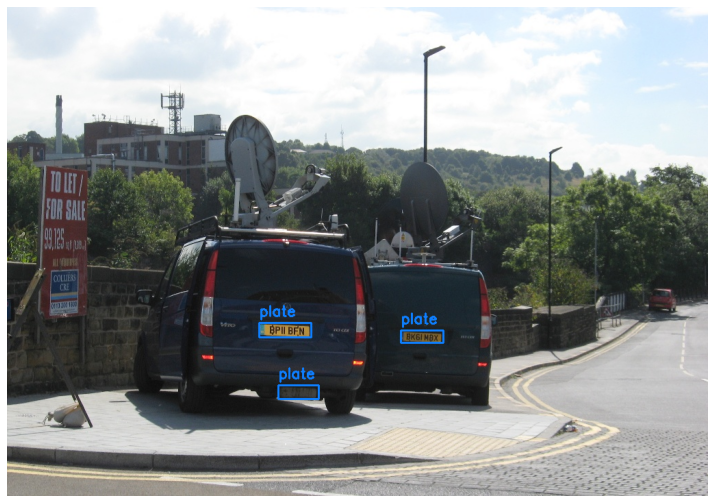

{'boxes': tensor([[368.5628, 462.0776, 444.0110, 483.9492],
         [575.5482, 473.2944, 637.2001, 491.5594],
         [396.6601, 553.9011, 455.6522, 573.7014],
         [366.0774, 459.2692, 449.2789, 502.3159],
         [338.1114, 453.6857, 452.1112, 490.1475],
         [416.8539, 556.2764, 451.2353, 573.0804],
         [575.4640, 466.1358, 642.6631, 503.2186],
         [ 62.9610, 387.3511, 104.9667, 419.8476],
         [ 61.8249, 425.2941, 105.7545, 451.5281]]),
 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1]),
 'scores': tensor([0.9939, 0.9917, 0.7686, 0.4788, 0.1936, 0.1116, 0.1073, 0.0951, 0.0581])}

In [86]:
val_filenames = list(filename_to_bbox_val_dict.keys())
filename = np.random.choice(val_filenames)
visualize_prediction_plate(filename, model, id_to_name={1: 'plate'}, thresh=0.5)

Class: plate, Confidence: 0.9583461284637451
Class: plate, Confidence: 0.9533889293670654
Class: plate, Confidence: 0.8023443222045898


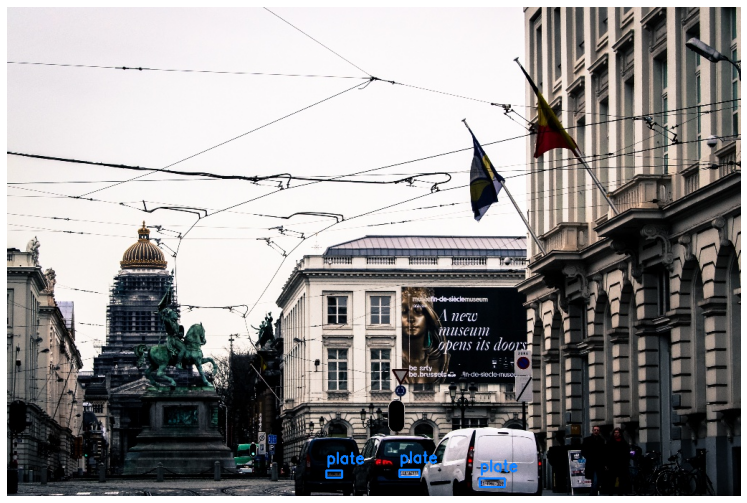

{'boxes': tensor([[547.9467, 646.8503, 575.8675, 656.5297],
         [659.0110, 658.2353, 694.9996, 670.9321],
         [445.0094, 647.9721, 467.3977, 657.6416],
         [786.7028, 656.4244, 806.3886, 668.1592],
         [588.7452, 666.5413, 619.8473, 680.9266],
         [633.6627, 657.1312, 700.5283, 677.5062],
         [444.7426, 651.5435, 467.0710, 660.4098],
         [786.2613, 653.1331, 813.7941, 670.6107],
         [447.4339, 645.2224, 465.0981, 654.9487]]),
 'labels': tensor([1, 1, 1, 1, 1, 1, 1, 1, 1]),
 'scores': tensor([0.9583, 0.9534, 0.8023, 0.1951, 0.1595, 0.1420, 0.1326, 0.0870, 0.0596])}

In [87]:
filename = np.random.choice(val_filenames)
visualize_prediction_plate(filename, model, id_to_name={1: 'plate'}, thresh=0.5)

# Полезные ссылки

На следующем занятии вы поговорите про сегментацию. Модели для детекции могут быть дообучены для сегментации.
Пример: https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html#

## Репозиторий с детектором от Facebook AI Research:
https://github.com/facebookresearch/detectron2

VIT  - vision transformer